In [2]:
#cnn-rnn using inceptionV3 trainning is done on the entire videos and processed by cutting the videos at time of trainning
from tensorflow_docs.vis import embed
from tensorflow import keras
from imutils import paths

import matplotlib.pyplot as plt
import tensorflow as tf
import pandas as pd
import numpy as np
import imageio
import cv2
import os

In [3]:
IMG_W = 224
IMG_H = 224
BATCH_SIZE = 64
EPOCHS = 20

MAX_SEQ_LENGTH = 1000
NUM_FEATURES = 2048

In [4]:
df1 = pd.read_csv("../data/female-mirror-data.csv")
df1["Action"] = df1["Action"].str.rstrip()
df1.head()

,Female Participant Number,Action,video-name,Unnamed: 3
0,1,Normal,1-FemaleNoGlasses-Normal.avi,NaN
1,1,Talking,1-FemaleNoGlasses-Talking.avi,NaN
2,1,Yawning,1-FemaleNoGlasses-Yawning.avi,NaN
3,2,Normal,2-FemaleNoGlasses-Normal.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...
4,2,Talking,2-FemaleNoGlasses-Talking.avi,C:\Users\bnich\Documents\_MyDocs\_School\2022-...


In [5]:

def crop_center_square(frame):
    y, x = frame.shape[0:2]
    min_dim = min(y, x)
    start_x = (x // 2) - (min_dim // 2)
    start_y = (y // 2) - (min_dim // 2)
    return frame[start_y : start_y + min_dim, start_x : start_x + min_dim]


def load_video(path, max_frames=0, resize=(IMG_H, IMG_W)):
    cap = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = crop_center_square(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == max_frames:
                break
    finally:
        cap.release()
    return np.array(frames)


In [6]:

def build_feature_extractor():
    feature_extractor = keras.applications.InceptionV3(
        weights="imagenet",
        include_top=False,
        pooling="avg",
        input_shape=(IMG_H, IMG_W, 3),
    )
    preprocess_input = keras.applications.inception_v3.preprocess_input

    inputs = keras.Input((IMG_H, IMG_W, 3))
    preprocessed = preprocess_input(inputs)

    outputs = feature_extractor(preprocessed)
    return keras.Model(inputs, outputs, name="feature_extractor")


feature_extractor = build_feature_extractor()

In [7]:
df1["target"] = (df1["Action"]=="Yawning")

In [8]:
i = 0
dfTrain = pd.DataFrame()
dfTest = pd.DataFrame()

while i<len(df1)/10:
    if i%5==0:
        dfTest = dfTest.append(df1.iloc[[i]])
    else :
        dfTrain = dfTrain.append(df1.iloc[[i]])

    i+=1

In [9]:

def prepare_all_videos(df, root_dir):
    num_samples = len(df)
    video_paths = df["video-name"].values.tolist()
    # print(video_paths)
    labels = df["target"].values

    # `frame_masks` and `frame_features` are what we will feed to our sequence model.
    # `frame_masks` will contain a bunch of booleans denoting if a timestep is
    # masked with padding or not.
    frame_masks = np.zeros(shape=(num_samples, MAX_SEQ_LENGTH), dtype="bool")
    frame_features = np.zeros(
        shape=(num_samples, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
    )

    # For each video.
    for idx, path in enumerate(video_paths):
        # Gather all its frames and add a batch dimension.
        frames = load_video(os.path.join(root_dir, path))
        frames = frames[None, ...]

        # Initialize placeholders to store the masks and features of the current video.
        temp_frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
        temp_frame_features = np.zeros(
            shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32"
        )

        # Extract features from the frames of the current video.
        for i, batch in enumerate(frames):
            video_length = batch.shape[0]
            length = min(MAX_SEQ_LENGTH, video_length)
            for j in range(length):
                temp_frame_features[i, j, :] = feature_extractor.predict(
                    batch[None, j, :]
                )
            temp_frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

        frame_features[idx,] = temp_frame_features.squeeze()
        frame_masks[idx,] = temp_frame_mask.squeeze()

    return (frame_features, frame_masks), labels


train_data, train_labels = prepare_all_videos(dfTrain, "../data/YawDD/YawDD dataset/Mirror/Female_mirror/")
test_data, test_labels = prepare_all_videos(dfTest, "../data/YawDD/YawDD dataset/Mirror/Female_mirror/")

print(f"Frame features in train set: {train_data[0].shape}")
print(f"Frame masks in train set: {train_data[1].shape}")

Frame features in train set: (12, 1000, 2048)
Frame masks in train set: (12, 1000)


In [10]:
# Utility for our sequence model.
def get_sequence_model():
    #class_vocab = label_processor.get_vocabulary()

    frame_features_input = keras.Input((MAX_SEQ_LENGTH, NUM_FEATURES))
    mask_input = keras.Input((MAX_SEQ_LENGTH,), dtype="bool")

    x = keras.layers.GRU(16, return_sequences=True)(
        frame_features_input, mask=mask_input
    )
    x = keras.layers.GRU(8)(x)
    x = keras.layers.Dropout(0.4)(x)
    x = keras.layers.Dense(8, activation="relu")(x)
    output = keras.layers.Dense(2, activation="softmax")(x)

    rnn_model = keras.Model([frame_features_input, mask_input], output)

    rnn_model.compile(
        loss="sparse_categorical_crossentropy", optimizer="adam", metrics=["accuracy"]
    )
    return rnn_model


# Utility for running experiments.
def run_experiment():
    filepath = "./video_classifier"
    checkpoint = keras.callbacks.ModelCheckpoint(
        filepath, save_weights_only=True, save_best_only=True, verbose=1
    )

    seq_model = get_sequence_model()
    history = seq_model.fit(
        [train_data[0], train_data[1]],
        train_labels,
        validation_split=0.3,
        epochs=EPOCHS,
        callbacks=[checkpoint],
    )

    seq_model.load_weights(filepath)
    _, accuracy = seq_model.evaluate([test_data[0], test_data[1]], test_labels)
    print(f"Test accuracy: {round(accuracy * 100, 2)}%")

    return history, seq_model


_, sequence_model = run_experiment()

Epoch 1/20
1/1 [==============================] - 18s 18s/step - loss: 0.6392 - accuracy: 0.7500 - val_loss: 0.7108 - val_accuracy: 0.5000

Epoch 00001: val_loss improved from inf to 0.71085, saving model to .\video_classifier
Epoch 2/20
1/1 [==============================] - 0s 332ms/step - loss: 0.5759 - accuracy: 0.7500 - val_loss: 0.7218 - val_accuracy: 0.5000

Epoch 00002: val_loss did not improve from 0.71085
Epoch 3/20
1/1 [==============================] - 0s 330ms/step - loss: 0.6220 - accuracy: 0.7500 - val_loss: 0.7226 - val_accuracy: 0.5000

Epoch 00003: val_loss did not improve from 0.71085
Epoch 4/20
1/1 [==============================] - 0s 312ms/step - loss: 0.5480 - accuracy: 0.7500 - val_loss: 0.7555 - val_accuracy: 0.5000

Epoch 00004: val_loss did not improve from 0.71085
Epoch 5/20
1/1 [==============================] - 0s 319ms/step - loss: 0.5733 - accuracy: 0.7500 - val_loss: 0.7611 - val_accuracy: 0.5000

Epoch 00005: val_loss did not improve from 0.71085
Epoch

Test video path: 2-FemaleNoGlasses-Yawning.avi
586
  No yawn: 60.87%
  Yes yawn: 39.13%



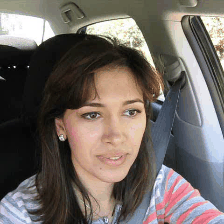

In [17]:

def prepare_single_video(frames):
    frames = frames[None, ...]
    frame_mask = np.zeros(shape=(1, MAX_SEQ_LENGTH,), dtype="bool")
    frame_features = np.zeros(shape=(1, MAX_SEQ_LENGTH, NUM_FEATURES), dtype="float32")

    for i, batch in enumerate(frames):
        video_length = batch.shape[0]
        length = min(MAX_SEQ_LENGTH, video_length)
        print(length)
        for j in range(length):
            frame_features[i, j, :] = feature_extractor.predict(batch[None, j, :])
        frame_mask[i, :length] = 1  # 1 = not masked, 0 = masked

    return frame_features, frame_mask


def sequence_prediction(path):
    class_vocab = ["No yawn", "Yes yawn"]

    frames = load_video(os.path.join("../data/YawDD/YawDD dataset/Mirror/Female_mirror/", path))
    frame_features, frame_mask = prepare_single_video(frames)
    probabilities = sequence_model.predict([frame_features, frame_mask])[0]

    for i in np.argsort(probabilities)[::-1]:
        print(f"  {class_vocab[i]}: {probabilities[i] * 100:5.2f}%")
    return frames

def to_gif(images):
    converted_images = images.astype(np.uint8)
    imageio.mimsave("animation.gif", converted_images, fps=10)
    return embed.embed_file("animation.gif")


test_video = np.random.choice(dfTest["video-name"].values.tolist())
print(f"Test video path: {test_video}")
test_frames = sequence_prediction(test_video)
to_gif(test_frames[:MAX_SEQ_LENGTH])